<a href="https://colab.research.google.com/github/aliahalotaibi73/Awake_Assist_ComputerVision/blob/main/Awake_Assist.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Install Important libraries

In [1]:
!pip install streamlit opencv-python-headless ultralytics
!pip install roboflow
!pip install playsound
!pip install pydub
!apt-get install ffmpeg -y

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.9/41.9 kB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.7/8.7 MB 37.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 882.8/882.8 kB 31.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 11.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 58.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.3/79.3 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 896.5 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.4/80.4 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 4.7 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
  Preparing metadata (setup.py) ... done
  Created wheel for playsound:

## Import libraries

In [2]:
import cv2
import os
from ultralytics import YOLO
from roboflow import Roboflow
import time
from playsound import playsound
from pydub import AudioSegment
from google.colab.patches import cv2_imshow
from IPython.display import display, Image, Audio
from IPython import display
from collections import defaultdict
import matplotlib.pyplot as plt
import glob
display.clear_output()
!yolo mode=checks

Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/cfg/__init__.py", line 772, in entrypoint
    raise ValueError(f"Invalid 'mode={mode}'. Valid modes are {MODES}.\n{CLI_HELP_MSG}")
ValueError: Invalid 'mode=<module 'ultralytics.utils.checks' from '/usr/local/lib/python3.10/dist-packages/ultralytics/utils/checks.py'>'. Valid modes are {'val', 'predict', 'train', 'export', 'track', 'benchmark'}.

    Arguments received: ['yolo', 'mode=checks']. Ultralytics 'yolo' commands use the following syntax:

        yolo TASK MODE ARGS

        Where   TASK (optional) is one of {'segment', 'pose', 'obb', 'detect', 'classify'}
                MODE (required) is one of {'val', 'predict', 'train', 'export', 'track', 'benchmark'}
                ARGS (optional) are any number of custom 'arg=value' pairs like 'imgsz=320' that override defaults.
                    See all ARGS at ht

## Upload The dataset from roboflow

In [3]:
rf = Roboflow(api_key="M9buI2U8yZ7pLqstU4cc")
project = rf.workspace("t5-3pals").project("drowsiness-detection-0t0rn")
version = project.version(8)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.3.5, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to Drowsiness-Detection-8 in yolov8:: 100%|██████████| 4022/4022 [00:00<00:00, 4695.15it/s]


## Model training

In [4]:
!yolo task=detect mode=train model=yolov8m.pt data=/content/Drowsiness-Detection-8/data.yaml epochs=30 imgsz=640

100% 49.7M/49.7M [00:00<00:00, 122MB/s]
Ultralytics 8.3.5 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/Drowsiness-Detection-8/data.yaml, epochs=30, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_cr

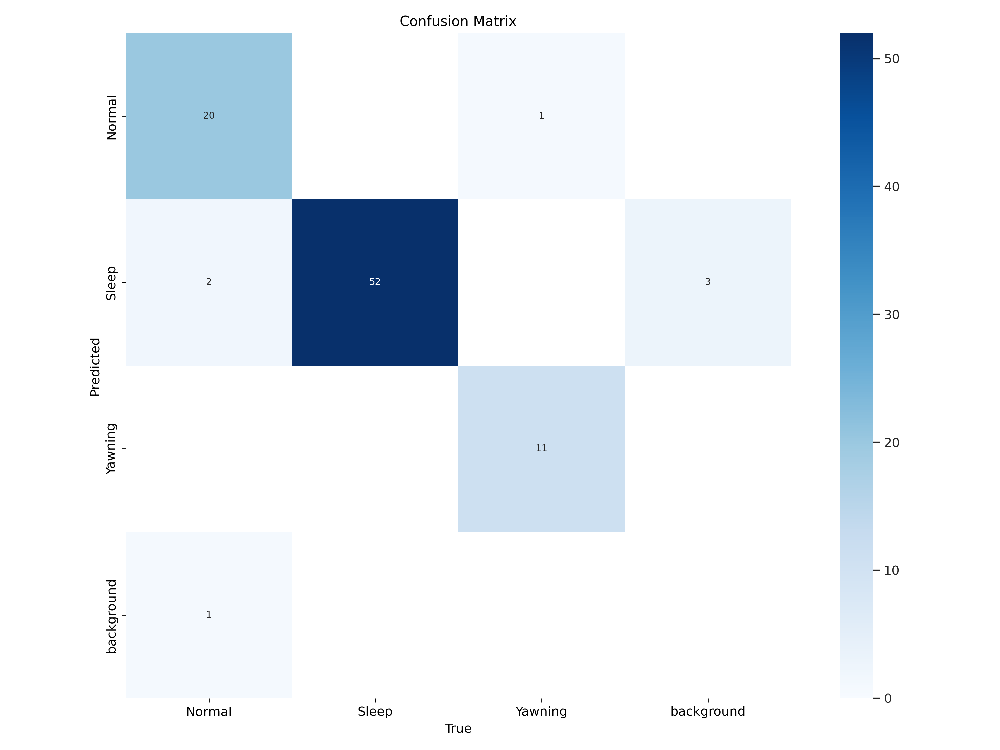

In [5]:
Image(filename=f'/content/runs/detect/train/confusion_matrix.png', width=600) # To display confusion matrix

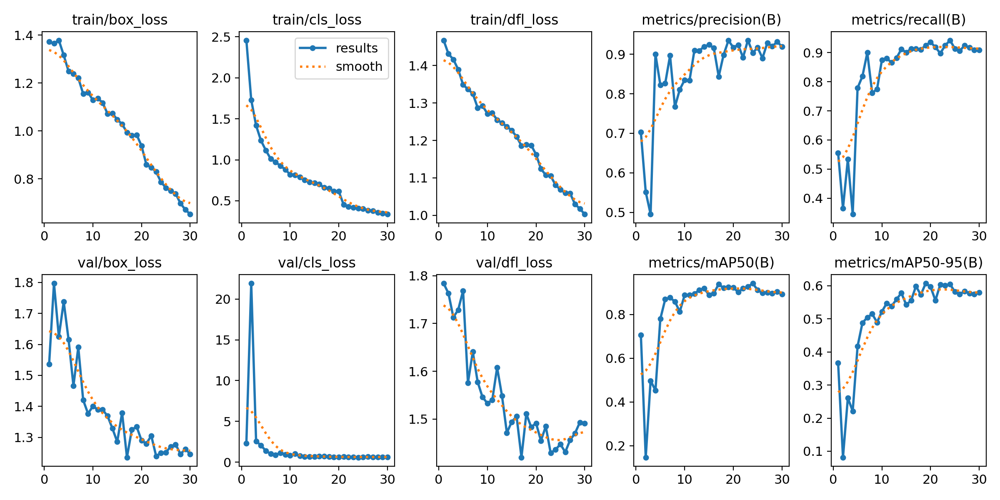

In [6]:
Image(filename=f'/content/runs/detect/train/results.png', width=600) # To display results

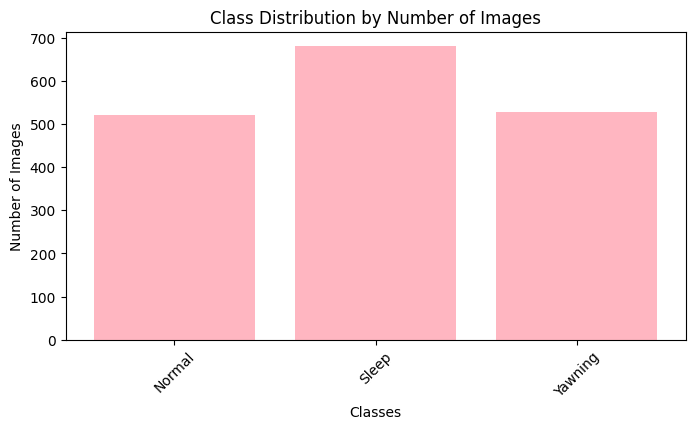

In [7]:
annotations_path = "/content/Drowsiness-Detection-8/train/labels"

# Initialize a dictionary to track images containing each class
image_class_counter = defaultdict(set)

# Loop through each annotation file and note which classes are in each image
for annotation_file in os.listdir(annotations_path):
    if annotation_file.endswith('.txt'):
        image_path = os.path.join(annotations_path, annotation_file)
        with open(image_path, 'r') as f:
            image_classes = set()
            for line in f.readlines():
                class_id = line.split()[0]
                image_classes.add(class_id)

            for class_id in image_classes:
                image_class_counter[class_id].add(annotation_file)

# Map class IDs to class names
class_names = ["Normal", "Sleep", "Yawning"]

# Convert the counts into lists for plotting
class_ids = [int(cid) for cid in image_class_counter.keys()]
image_counts = [len(image_class_counter[cid]) for cid in image_class_counter.keys()]
class_labels = [class_names[i] for i in class_ids]

# Plotting as bar chart
plt.figure(figsize=(8, 4))
plt.bar(class_labels, image_counts, color='lightpink')
plt.xlabel('Classes')
plt.ylabel('Number of Images')
plt.title('Class Distribution by Number of Images')
plt.xticks(rotation=45)
plt.show()

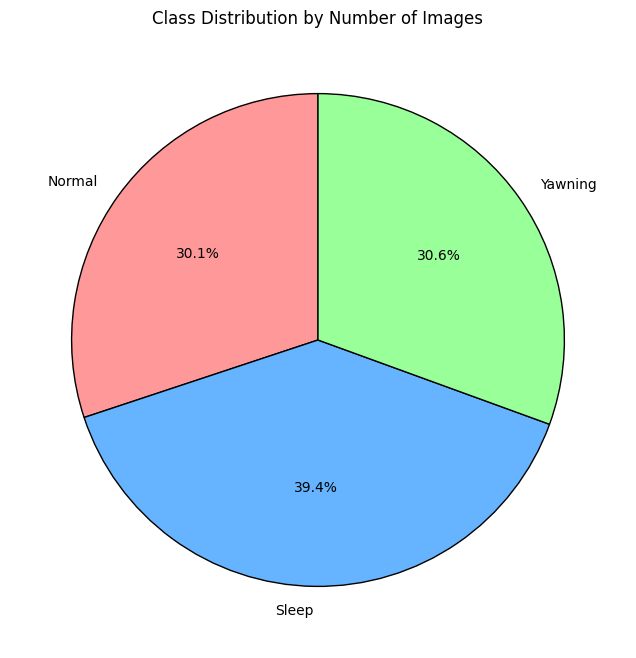

In [8]:
annotations_path = "/content/Drowsiness-Detection-8/train/labels"

# Initialize a dictionary to track images containing each class
image_class_counter = defaultdict(set)

# Loop through each annotation file and note which classes are in each image
for annotation_file in os.listdir(annotations_path):
    if annotation_file.endswith('.txt'):
        image_path = os.path.join(annotations_path, annotation_file)
        with open(image_path, 'r') as f:
            image_classes = set()
            for line in f.readlines():
                class_id = line.split()[0]
                image_classes.add(class_id)

            for class_id in image_classes:
                image_class_counter[class_id].add(annotation_file)

# Map class IDs to class names
class_names = ["Normal", "Sleep", "Yawning"]

# Convert the counts into lists for plotting
class_ids = [int(cid) for cid in image_class_counter.keys()]
image_counts = [len(image_class_counter[cid]) for cid in image_class_counter.keys()]
class_labels = [class_names[i] for i in class_ids]

# Plotting as a pie chart
plt.figure(figsize=(8, 8))
plt.pie(image_counts, labels=class_labels, autopct='%1.1f%%', colors=['#ff9999','#66b3ff','#99ff99'], startangle=90, wedgeprops={'edgecolor': 'black'})
plt.title('Class Distribution by Number of Images')
plt.show()


## Load the trained YOLOv8 model

In [9]:
model = YOLO("/content/runs/detect/train/weights/best.pt")

## Run predictions

In [11]:
!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.8 source="/content/P1042772_720.mp4"

Ultralytics 8.3.5 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 236 layers, 23,204,569 parameters, 0 gradients, 67.4 GFLOPs

video 1/1 (frame 1/3105) /content/P1042772_720.mp4: 384x640 (no detections), 70.2ms
video 1/1 (frame 2/3105) /content/P1042772_720.mp4: 384x640 (no detections), 23.4ms
video 1/1 (frame 3/3105) /content/P1042772_720.mp4: 384x640 (no detections), 23.4ms
video 1/1 (frame 4/3105) /content/P1042772_720.mp4: 384x640 (no detections), 23.4ms
video 1/1 (frame 5/3105) /content/P1042772_720.mp4: 384x640 (no detections), 23.4ms
video 1/1 (frame 6/3105) /content/P1042772_720.mp4: 384x640 (no detections), 23.3ms
video 1/1 (frame 7/3105) /content/P1042772_720.mp4: 384x640 (no detections), 23.3ms
video 1/1 (frame 8/3105) /content/P1042772_720.mp4: 384x640 (no detections), 16.6ms
video 1/1 (frame 9/3105) /content/P1042772_720.mp4: 384x640 (no detections), 16.7ms
video 1/1 (frame 10/3105) /content/P1042772_720.mp4: 384x640 (no detections), 1

## Check if WAV file exists

In [12]:
wav_file_path = "/content/alert-85101.wav"
if os.path.isfile(wav_file_path):
    print(f"WAV file found at: {wav_file_path}")
else:
    print(f"WAV file not found at: {wav_file_path}")

WAV file found at: /content/alert-85101.wav


## Initialize video capture

In [13]:
video_path = "/content/runs/detect/predict2/P1042772_720.avi"
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    print("Error: Could not open video.")
    exit()


frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)

out = cv2.VideoWriter('/content/saved_video_with_alert.mp4', cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

## Initialize variables and function create alert audio

In [14]:
# Initialize needed variables
sleep_start_time = None
alert_triggered = False
sleep_threshold = 0.5  #in seconds
wav_file_path = "/content/alert-85101.wav"
alert_times = []  #we create this list to store times when alert is triggered and detect sleep

def predict_on_frame(frame):
    results = model(frame)
    sleep_detected = False

    for result in results:
        for box in result.boxes:
            class_id = int(box.cls)
            if class_id == 1:  # this based on class ID ( sleep class have ID 1 , normal ID 0, yawning ID 2 )
                sleep_detected = True
                break

    return sleep_detected, results[0].plot()

#video processing loop
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        print("Error: Failed to grab frame.")
        break

    closed_eyes_detected, processed_frame = predict_on_frame(frame)

    # Drowsiness detection loop
    if closed_eyes_detected:
        if sleep_start_time is None:
            sleep_start_time = time.time()  #Set start time when sleeping driver is detected so count then trigger the alert
        elif time.time() - sleep_start_time >= sleep_threshold and not alert_triggered:
            print("Driver asleep for too long! Alert!")
            current_time = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            alert_times.append(current_time)
            alert_triggered = True
    else:
        sleep_start_time = None
        alert_triggered = False

    # Write the processed frame to output
    out.write(processed_frame)

# Release resources
cap.release()
out.release()
cv2.destroyAllWindows()

#Print recorded alert times
print("Alert times recorded:", alert_times)

#This function to create the alert audio file based on logged times
def create_alert_audio(alert_times, wav_file_path, output_audio_path):
    alert_sound = AudioSegment.from_wav(wav_file_path)
    final_audio = AudioSegment.silent(duration=0)  # Start with silence

    previous_alert_time = 0  # Initialize with zero

    # Loop through each alert time and concatenate the alert sound
    for alert_time in alert_times:
        # Calculate the silence duration between consecutive alerts
        silence_duration = int((alert_time - previous_alert_time) * 1000)
        if silence_duration > 0:
            final_audio += AudioSegment.silent(duration=silence_duration)
        final_audio += alert_sound
        previous_alert_time = alert_time

    #The final audio
    final_audio.export(output_audio_path, format="wav")
#Create the alert audio
output_audio_path = "/content/alert_audio.wav"
create_alert_audio(alert_times, wav_file_path, output_audio_path)

#Check if the alert audio file was created correctly
if os.path.isfile(output_audio_path):
    print(f"Alert audio file created at: {output_audio_path}")
else:
    print("Failed to create alert audio file.")

Streaming output truncated to the last 5000 lines.
Speed: 2.2ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 13.9ms
Speed: 4.2ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 15.9ms
Speed: 2.5ms preprocess, 15.9ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 15.7ms
Speed: 2.2ms preprocess, 15.7ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 18.9ms
Speed: 2.2ms preprocess, 18.9ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 19.4ms
Speed: 2.3ms preprocess, 19.4ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 23.2ms
Speed: 2.3ms preprocess, 23.2ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Normal, 13.9ms
Speed: 2.4ms preprocess, 

## Combine the video and audio

In [15]:
#This to combine video processed and audio that created using def create_alert_audio using ffmpeg
output_video_path = "/content/saved_video_with_alert.mp4"
final_output_path = "/content/final_output_with_alert.mp4"
!ffmpeg -i {output_video_path} -i {output_audio_path} -c:v copy -c:a aac {final_output_path}

#Check if the final output was created
if os.path.isfile(final_output_path):
    print(f"Final output file created at: {final_output_path}")
else:
    print("Failed to create final output file.")

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

## Check if alert is stored

In [16]:
alert_times

[0.96,
 1.68,
 4.08,
 5.64,
 7.68,
 10.48,
 13.6,
 14.52,
 17.28,
 20.48,
 21.88,
 23.2,
 25.52,
 31.16,
 34.44,
 39.44,
 42.12,
 43.28,
 48.64,
 51.76,
 54.08,
 55.04,
 59.16000000000001,
 62.480000000000004,
 65.2,
 67.32000000000002,
 69.68,
 73.28,
 76.56,
 82.48,
 84.16,
 86.64,
 93.16,
 94.36,
 97.60000000000001,
 101.0,
 102.4,
 105.04,
 108.28,
 108.92,
 112.0,
 116.12,
 117.72,
 123.64]

## Make prediction on test images

In [17]:
!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.8 source="/content/Drowsiness-Detection-8/test/images"

Ultralytics 8.3.5 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 236 layers, 23,204,569 parameters, 0 gradients, 67.4 GFLOPs

image 1/186 /content/Drowsiness-Detection-8/test/images/107_jpg.rf.6d57aed2452d39677c1927436e401222.jpg: 640x640 1 Yawning, 33.6ms
image 2/186 /content/Drowsiness-Detection-8/test/images/10_jpg.rf.1bd4fe62d1cb301cc76706dc65ba22c3.jpg: 640x640 1 Yawning, 33.7ms
image 3/186 /content/Drowsiness-Detection-8/test/images/10_jpg.rf.290d37c4904fe7f8c76d07f3d9c8eeea.jpg: 640x640 1 Yawning, 33.6ms
image 4/186 /content/Drowsiness-Detection-8/test/images/10_jpg.rf.2d193588715669f92101bd7d44de3f75.jpg: 640x640 1 Yawning, 33.6ms
image 5/186 /content/Drowsiness-Detection-8/test/images/110_jpg.rf.2897aa890dcfacc112ed90f61c13acd3.jpg: 640x640 (no detections), 33.6ms
image 6/186 /content/Drowsiness-Detection-8/test/images/110_jpg.rf.dc6000874f5026805d05230a7181978f.jpg: 640x640 1 Yawning, 33.5ms
image 7/186 /content/Drowsiness-Detection-8/te

## Display prediction images

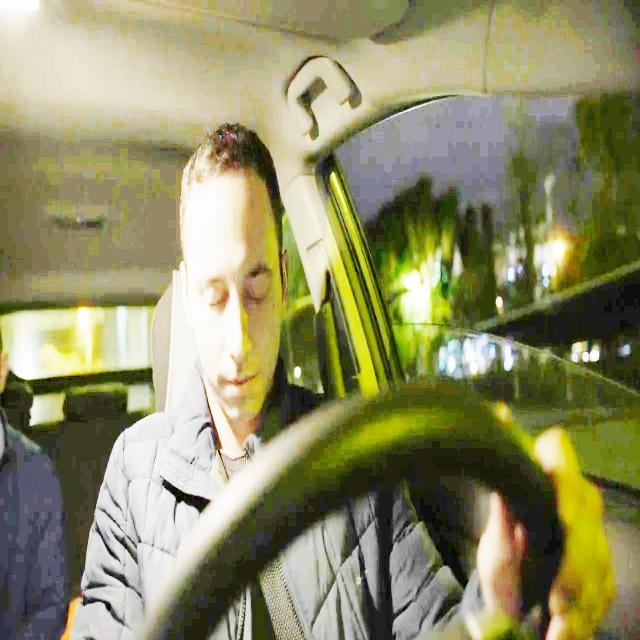

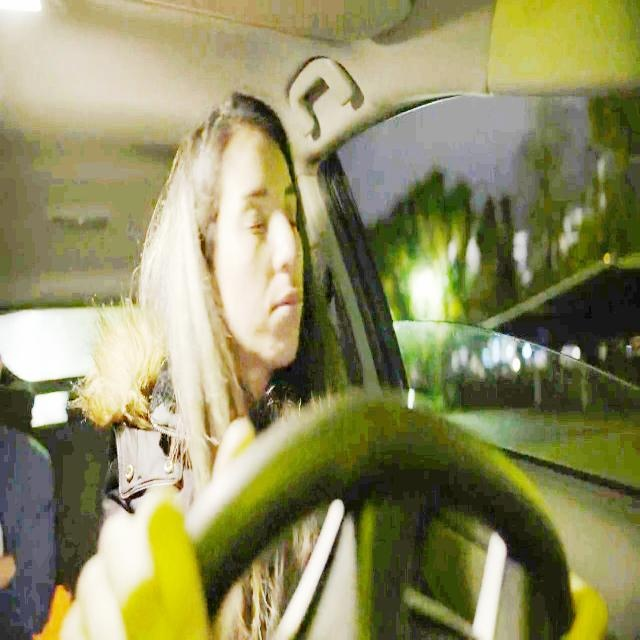

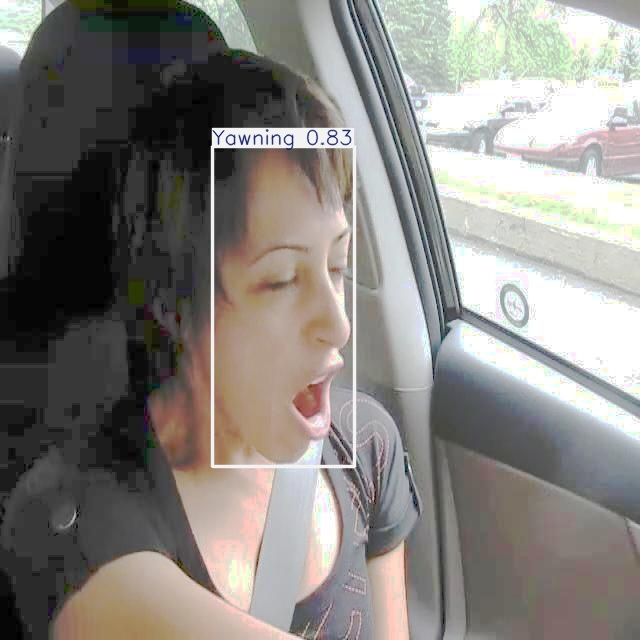

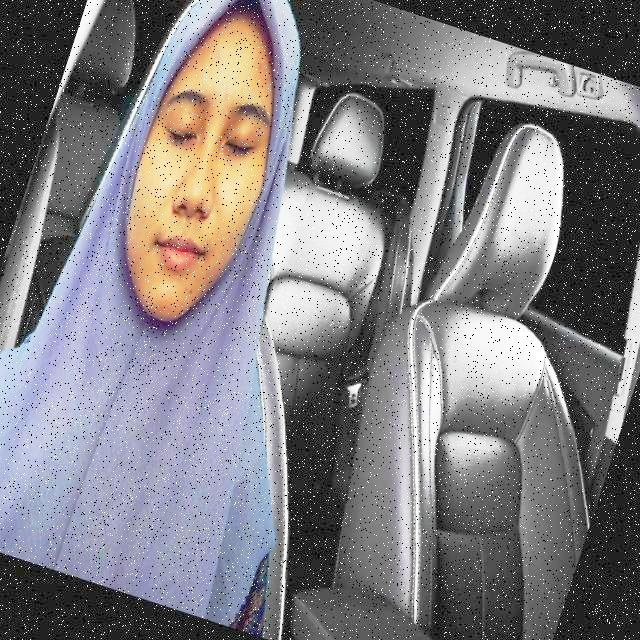

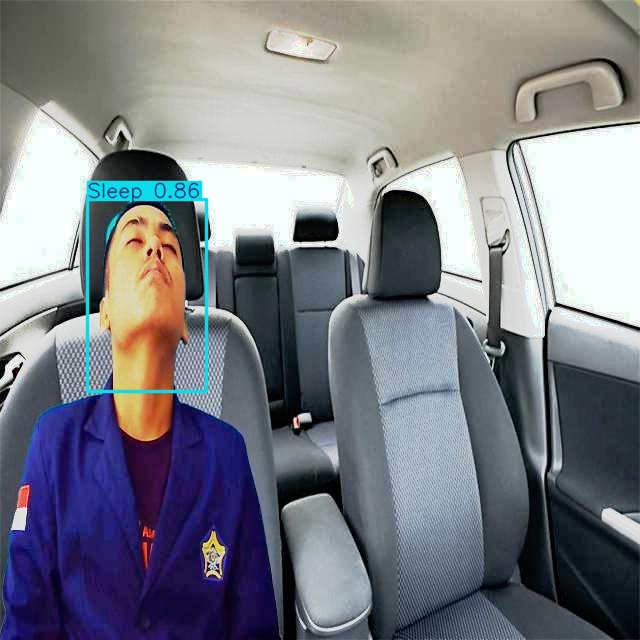

...

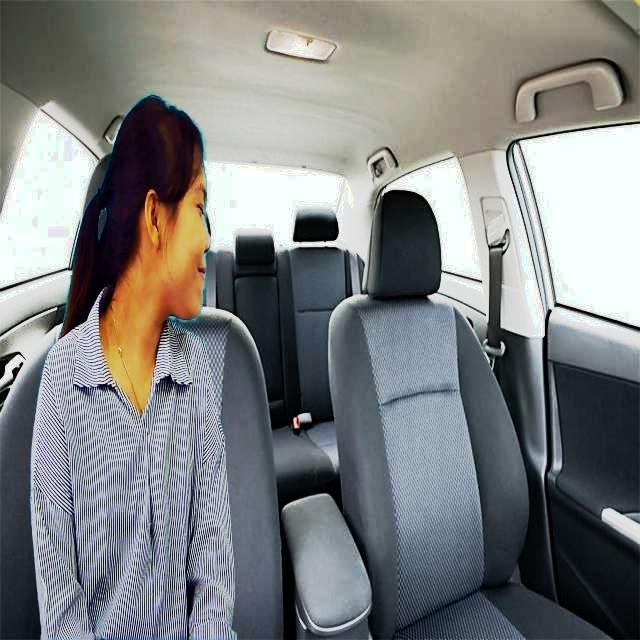

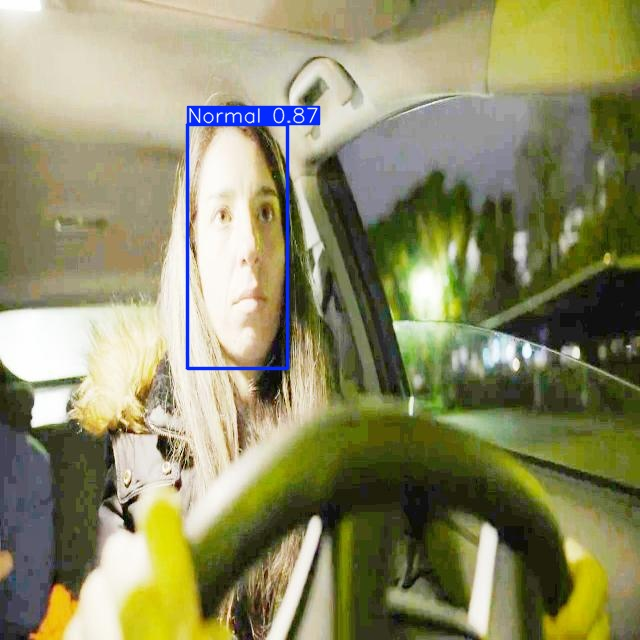

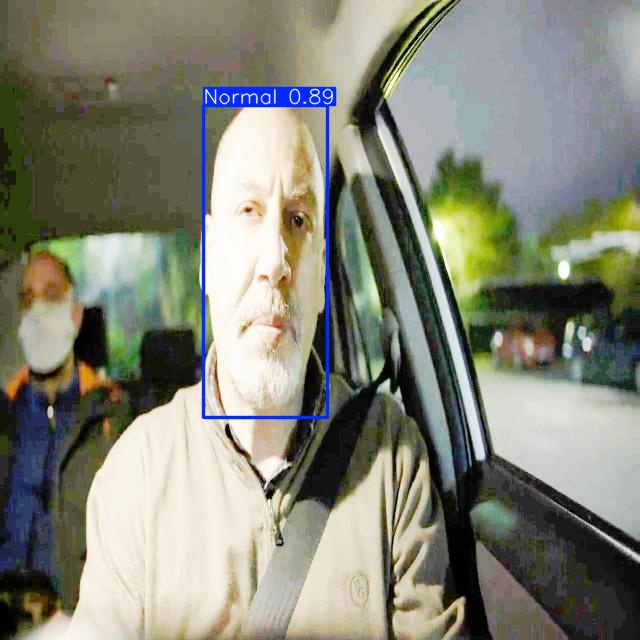

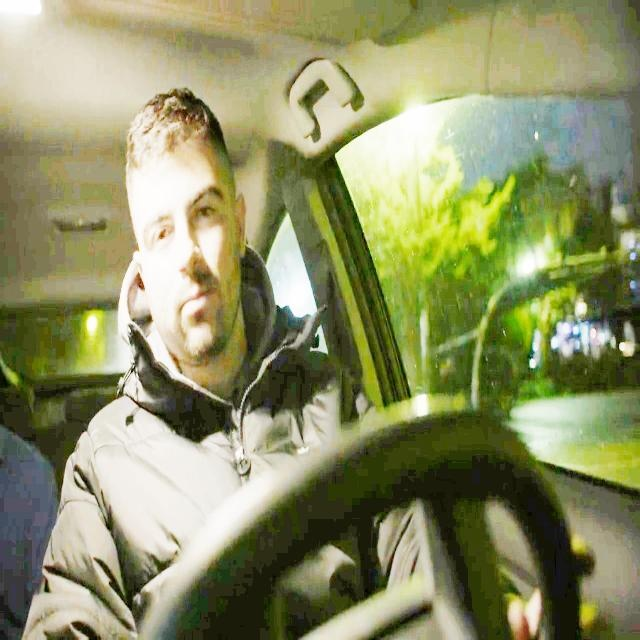

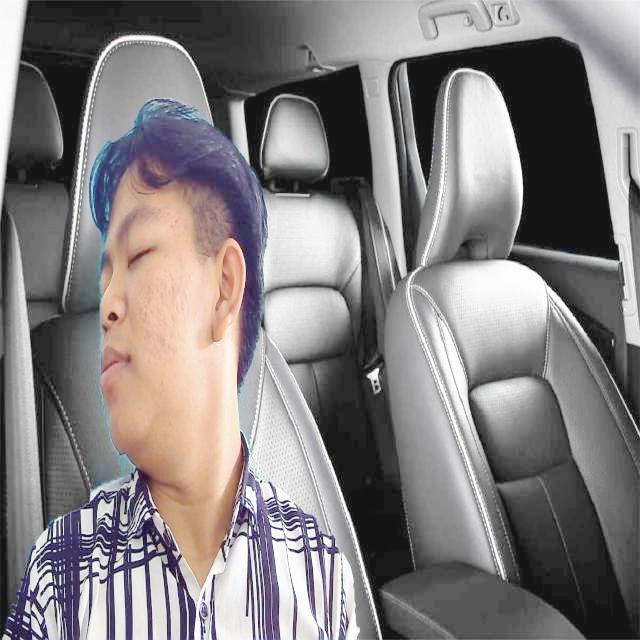

In [18]:
# Loop through the first three image paths in the specified directory
for image_path in glob.glob('/content/runs/detect/predict3/*.jpg'):
    display(Image(filename=image_path, height=600))
    print("\n")  # This will add a new line after each image